## Imports

In [126]:
import QuantumToolbox as qt
using Logging
import CairoMakie as cm
using MiniLoggers
using ProgressMeter
using LoggingExtras
using Revise
using Dates
using YAXArrays


In [127]:
import SuperconductingCavities as SC

## Logger Setups

In [128]:
# MiniLogger(minlevel = MiniLoggers.Info) |> global_logger
InfoLogger = MiniLogger(minlevel = MiniLoggers.Info)
ProgressLogger = MiniLogger(minlevel = LogLevel(-1))
DebugLogger = MiniLogger(minlevel = MiniLoggers.Debug)

global_logger(InfoLogger)

MinLevelLogger{FormatLogger, Base.CoreLogging.LogLevel}(FormatLogger(var"#153#154"(), IOStream(<file meow.log>), true), LogLevel(-1))

# Mode 3

In [297]:
Mode3 = SC.Circuits.Transmon_Resonators.load("ModelSaves/Mode3/Mode3.json");

In [179]:
Mode3.Stuff["Chirp Params"]

Dict{String, Any} with 1 entry:
  "fn_gn+1" => Any[Dict{String, Any}("resid"=>Any[-1.19117e-7, -1.20903e-6, 6.2…

## Error Budget Plot (Bare Loss Ops)

### Loading Data

In [125]:
init_states = ["g0", "e0", "g0_p_e0", "g0_m_e0", "g0_p_ie0", "g0_m_ie0"]
losses = ["Bare_All", "Bare_TC", "Bare_CC", "Bare_TD"]

itert = Iterators.product(init_states, losses)

Mode3ErrorBudgetBare = Dict{Any, Any}()

order = ["Step_1", "Step_2", "Step_3", "Step_4", "Step_5", "Step_6", "Step_7", "Step_8", "Step_9", "Step_10", "Step_11", "Step_12", "Step_13", "Step_14", "Step_15", "Step_16", "Step_17", "Step_18"]
for combo in itert
    file_name = "Data/"*combo[1]*"_Encoding_Mode3_"*combo[2]*".nc"
    @info file_name
    Mode3ErrorBudgetBare[combo] = SC.Utils.LoadRunResults(file_name, cube_order = order, h_dims = [10,10])
end


Progress:  34%|█████████████▊                           |  ETA: 0:00:26

InterruptException: InterruptException:

In [51]:
state_dict = Dict{Any, Any}()
for state in collect(Iterators.product([0,1,2], [0,1,2,3,4]))
    state_dict[state] = Mode3.dressed_states[state]
end

Projection_Ops = SC.Utils.Get_Projection_Ops(state_dict)

Probabilities = Dict{Any, Any}()
for key in keys(Mode3ErrorBudgetBare)
    @info "On $key"
    Probabilities[key] = SC.Utils.Get_EVs(Mode3ErrorBudgetBare[key]["states"], Projection_Ops)
end

[2024-10-04 17:35:24] Info: On ("g0", "Bare_TC")
[2024-10-04 17:35:27] Info: On ("g0_m_e0", "Bare_TC")
[2024-10-04 17:35:30] Info: On ("g0_p_ie0", "Bare_All")
[2024-10-04 17:35:32] Info: On ("g0_p_e0", "Bare_All")
[2024-10-04 17:35:35] Info: On ("g0_p_e0", "Bare_TC")
[2024-10-04 17:35:38] Info: On ("g0_m_ie0", "Bare_TC")
[2024-10-04 17:35:40] Info: On ("g0_p_e0", "Bare_CC")
[2024-10-04 17:35:43] Info: On ("g0", "Bare_TD")
[2024-10-04 17:35:46] Info: On ("g0_p_e0", "Bare_TD")
[2024-10-04 17:35:48] Info: On ("e0", "Bare_CC")
[2024-10-04 17:35:51] Info: On ("g0_m_e0", "Bare_CC")
[2024-10-04 17:35:54] Info: On ("e0", "Bare_TD")
[2024-10-04 17:35:57] Info: On ("g0_m_e0", "Bare_TD")
[2024-10-04 17:35:59] Info: On ("e0", "Bare_TC")
[2024-10-04 17:36:02] Info: On ("g0_m_ie0", "Bare_All")
[2024-10-04 17:36:05] Info: On ("g0_p_ie0", "Bare_CC")
[2024-10-04 17:36:08] Info: On ("g0_p_ie0", "Bare_TC")
[2024-10-04 17:36:11] Info: On ("g0", "Bare_All")
[2024-10-04 17:36:13] Info: On ("g0", "Bare_CC")


### Plotting All State Evolutions

[2024-10-04 17:42:08] Info: Making Plot
[2024-10-04 17:42:09] Info: Making Plot
[2024-10-04 17:42:11] Info: Making Plot
[2024-10-04 17:42:12] Info: Making Plot
[2024-10-04 17:42:14] Info: Making Plot
[2024-10-04 17:42:15] Info: Making Plot
[2024-10-04 17:42:17] Info: Making Plot
[2024-10-04 17:42:19] Info: Making Plot
[2024-10-04 17:42:20] Info: Making Plot
[2024-10-04 17:42:22] Info: Making Plot
[2024-10-04 17:42:23] Info: Making Plot
[2024-10-04 17:42:25] Info: Making Plot
[2024-10-04 17:42:27] Info: Making Plot
[2024-10-04 17:42:28] Info: Making Plot
[2024-10-04 17:42:30] Info: Making Plot
[2024-10-04 17:42:31] Info: Making Plot
[2024-10-04 17:42:33] Info: Making Plot
[2024-10-04 17:42:34] Info: Making Plot
[2024-10-04 17:42:36] Info: Making Plot
[2024-10-04 17:42:37] Info: Making Plot
[2024-10-04 17:42:39] Info: Making Plot
[2024-10-04 17:42:41] Info: Making Plot
[2024-10-04 17:42:42] Info: Making Plot
[2024-10-04 17:42:44] Info: Making Plot


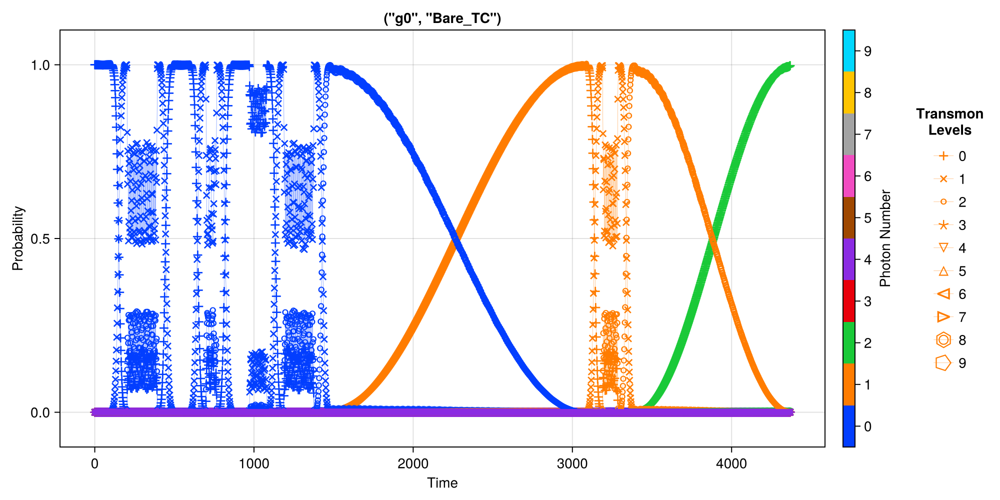

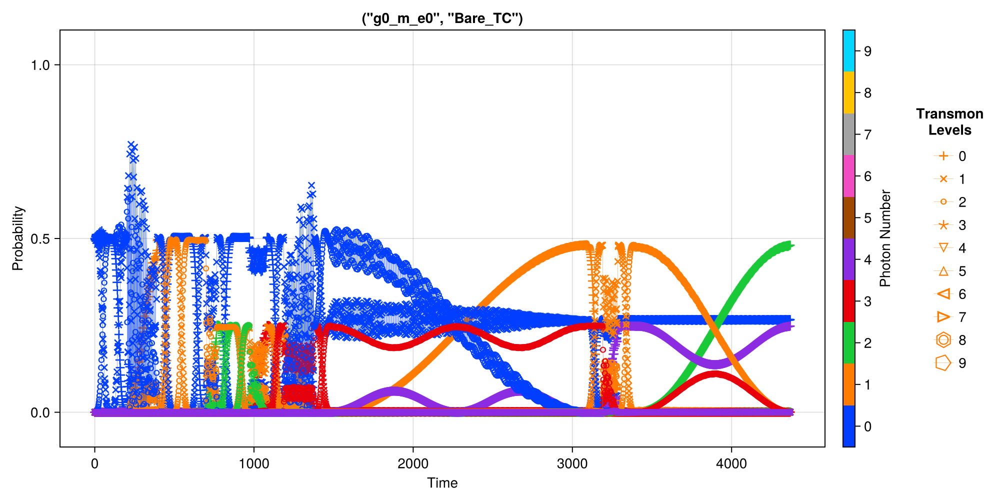

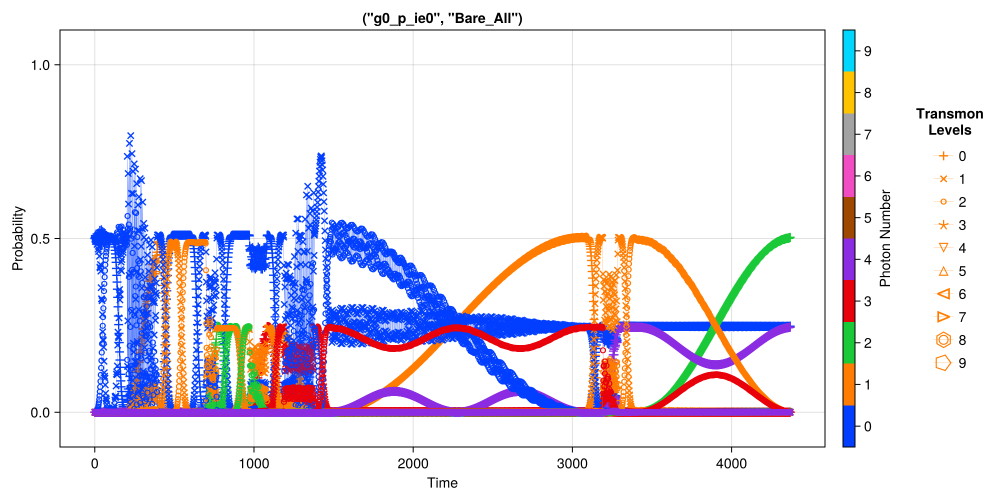

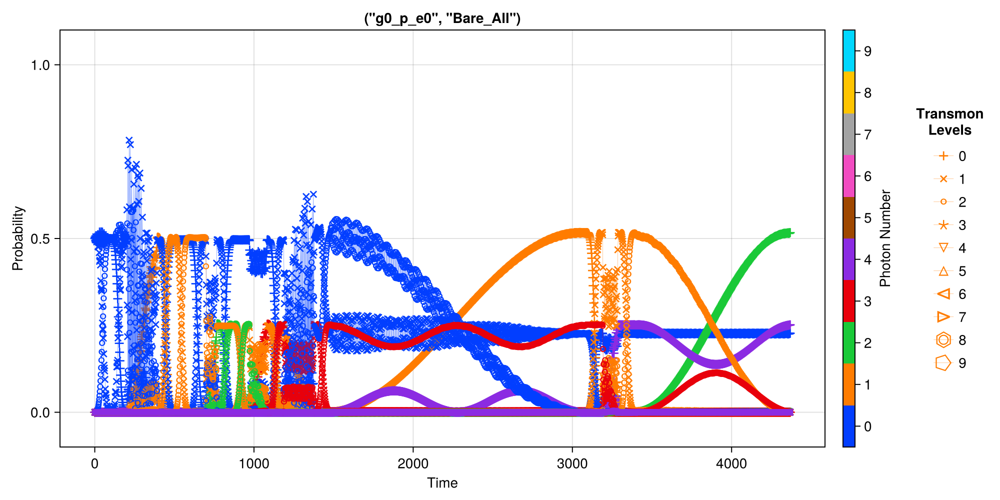

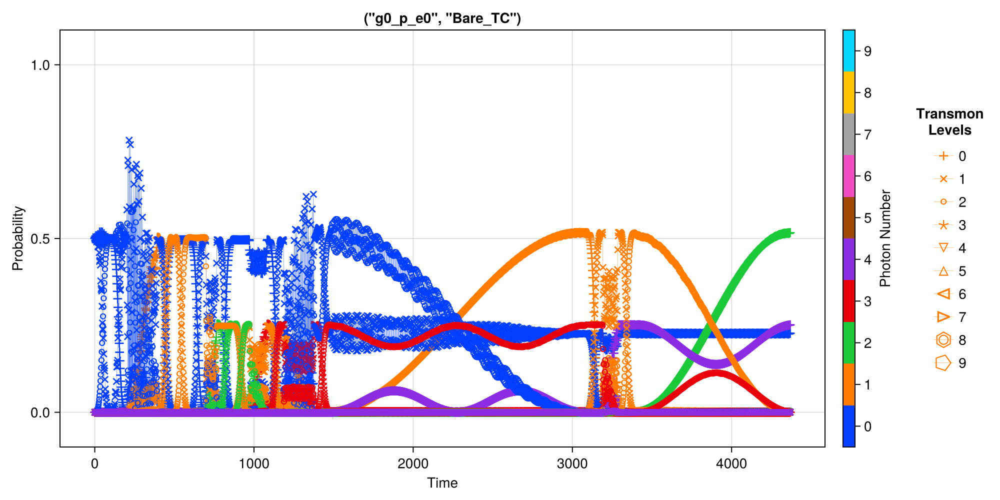

...

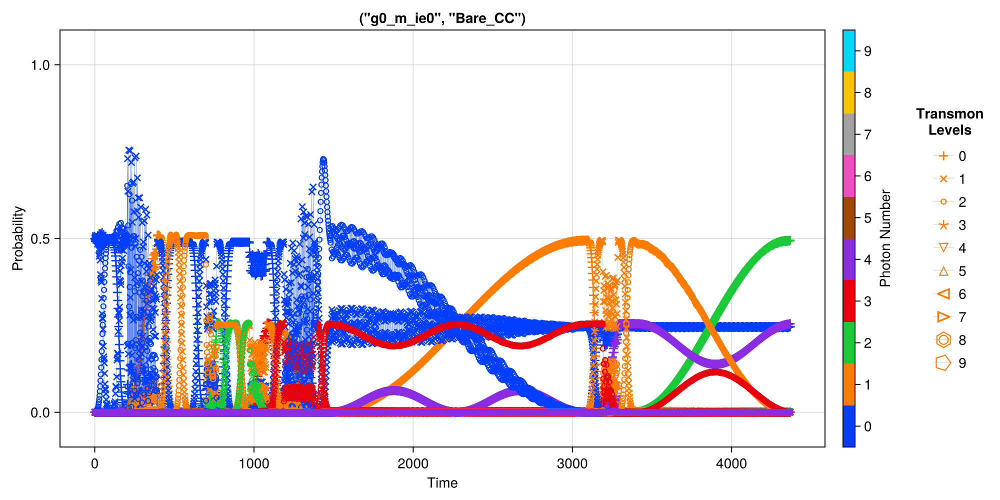

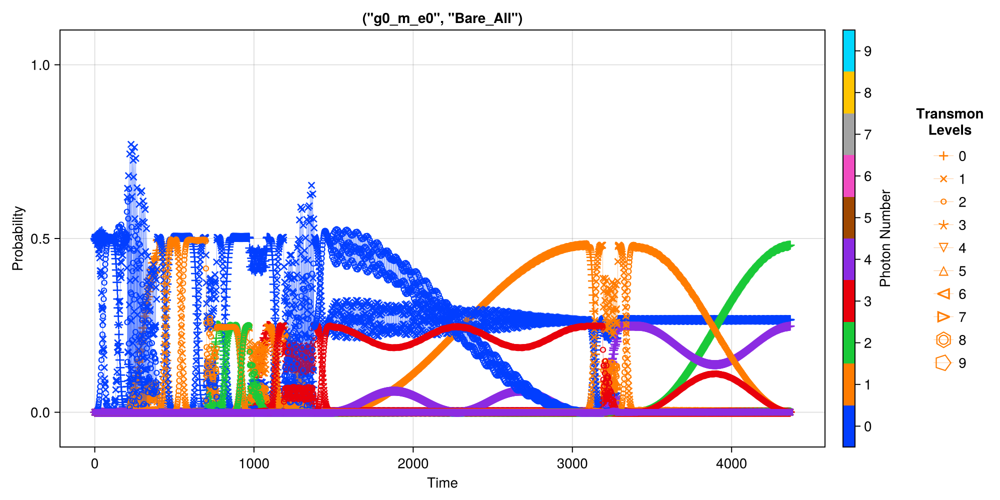

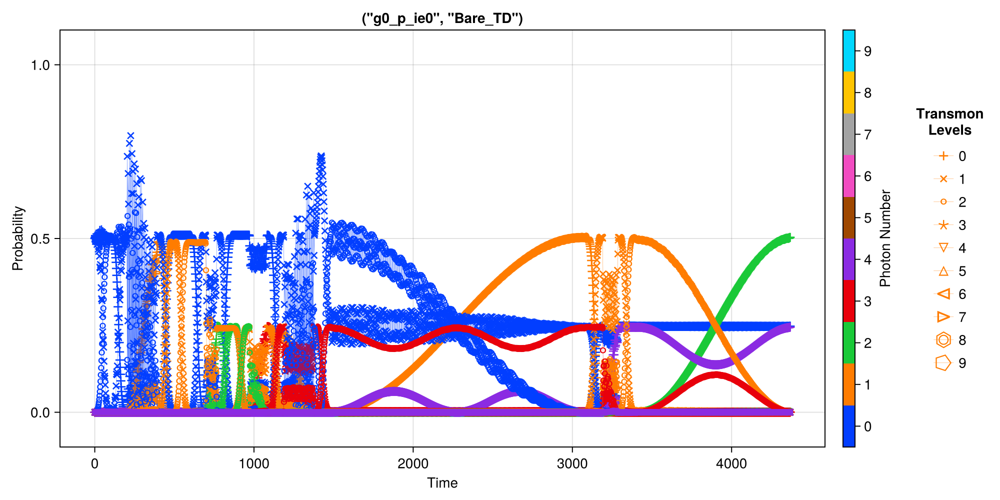

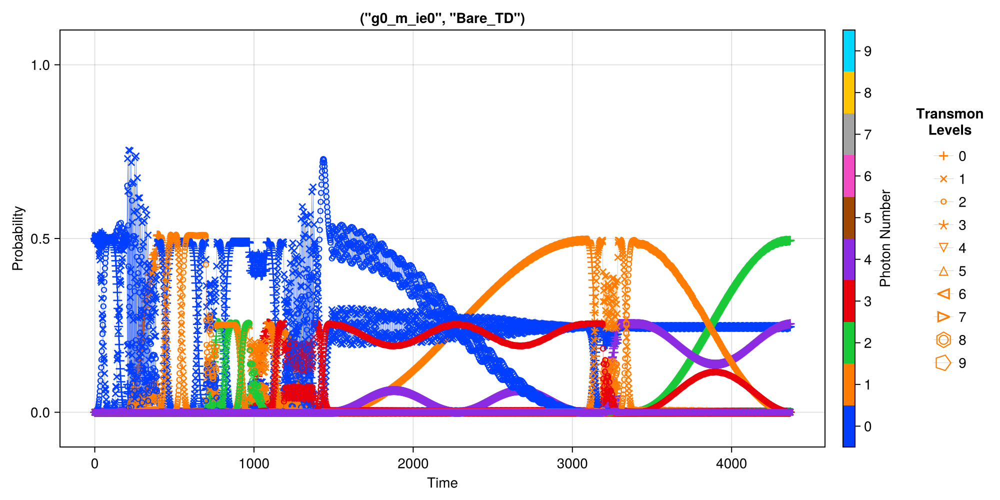

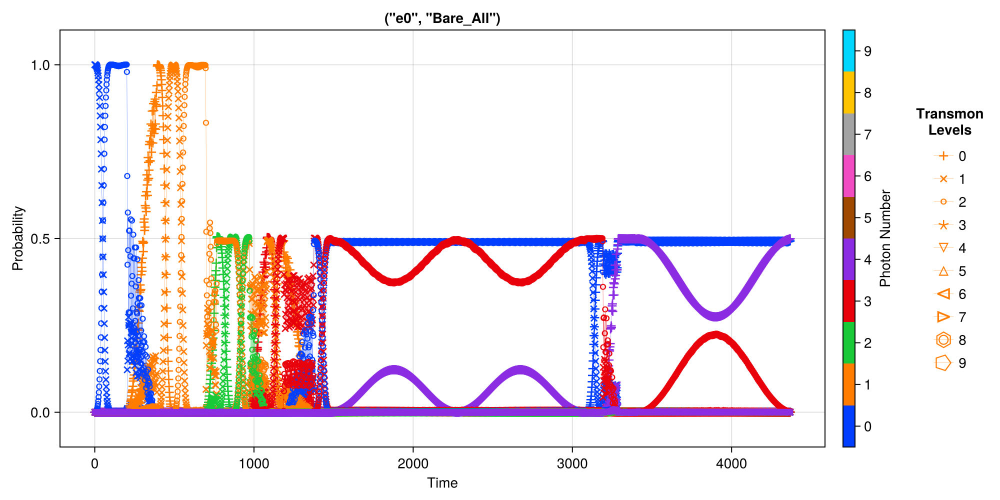

In [59]:
for key in keys(Mode3ErrorBudgetBare)
    Axis_kwargs = Dict{Any, Any}("title" => string(key))
    SC.Dynamics.PlotSingleModeEvolution(Mode3, Mode3ErrorBudgetBare[key]["times"], Probabilities[key], Axis_kwargs = Axis_kwargs)
end

# Plots of Ramp times and shapes

In [305]:
Mode3.Stuff["op_drive_params"]["f0g1_SS_10.0"]

Dict{String, Any} with 7 entries:
  "pulse_time"    => 197.572
  "Envelope Args" => Dict{String, Any}("pulse_time"=>197.572, "ramp_time"=>10)
  "epsilon"       => 0.78
  "Envelope"      => "Sine_Squared_Ramp"
  "shift"         => 0.0422004
  "accuracy"      => 0.999627
  "freq_d"        => -2.87015

In [314]:
Ramp_Times = [2.5, 5, 7.5, 10, 20, 40, 60]
envelopes = ["Sine_Squared_Ramp", "Gaussian_Ramp"]
chirped = [true, false]

res = Dict{Any, Any}()

for envelope in envelopes
    for rt in Ramp_Times
        for chirp in chirped
            drive_name = ""
            if envelope == "Sine_Squared_Ramp"
                drive_name = "f0g1_SS_"*string(rt)
            end
            if envelope == "Guassian_Ramp"
                drive_name = "f0g1_G_"*string(rt)
            end

            if chirp
                drive_name = drive_name*"_chirped"
            end

            if drive_name in keys(Mode3.Stuff["op_drive_params"])
                res[drive_name] = Mode3.Stuff["op_drive_params"][drive_name]["accuracy"]
            end
        end
    end
end

In [315]:
res

Dict{Any, Any} with 14 entries:
  "f0g1_SS_7.5_chirped"  => 0.0530573
  "f0g1_SS_2.5_chirped"  => 0.220589
  "f0g1_SS_40.0"         => 0.988791
  "f0g1_SS_40.0_chirped" => 0.999615
  "f0g1_SS_7.5"          => 0.999835
  "f0g1_SS_10.0"         => 0.999627
  "f0g1_SS_60.0"         => 0.981085
  "f0g1_SS_2.5"          => 0.998314
  "f0g1_SS_10.0_chirped" => 0.3211
  "f0g1_SS_5.0_chirped"  => 0.0541368
  "f0g1_SS_20.0_chirped" => 0.995491
  "f0g1_SS_60.0_chirped" => 0.996851
  "f0g1_SS_20.0"         => 0.997017
  "f0g1_SS_5.0"          => 0.99961

In [299]:
SS = []
SS_x = []
SS_chirp = []
SS_chirp_x = []

for key in keys(res)
    key_split = split(key, "_")
    if length(key_split) == 4
        push!(SS_chirp, res[key])
        push!(SS_chirp_x, Meta.parse(key_split[3]))
    else
        push!(SS, res[key])
        push!(SS_x, Meta.parse(key_split[3]))
    end
end


BoundsError: BoundsError: attempt to access 2-element Vector{SubString{String}} at index [3]

In [291]:
permvec = sortperm(SS_x)
SS = SS[permvec]
SS_x = sort(SS_x)

permvec = sortperm(SS_chirp_x)
SS_chirp = SS_chirp[permvec]
SS_chirp_x = sort(SS_chirp_x)

7-element Vector{Any}:
  2.5
  5.0
  7.5
 10.0
 20.0
 40.0
 60.0

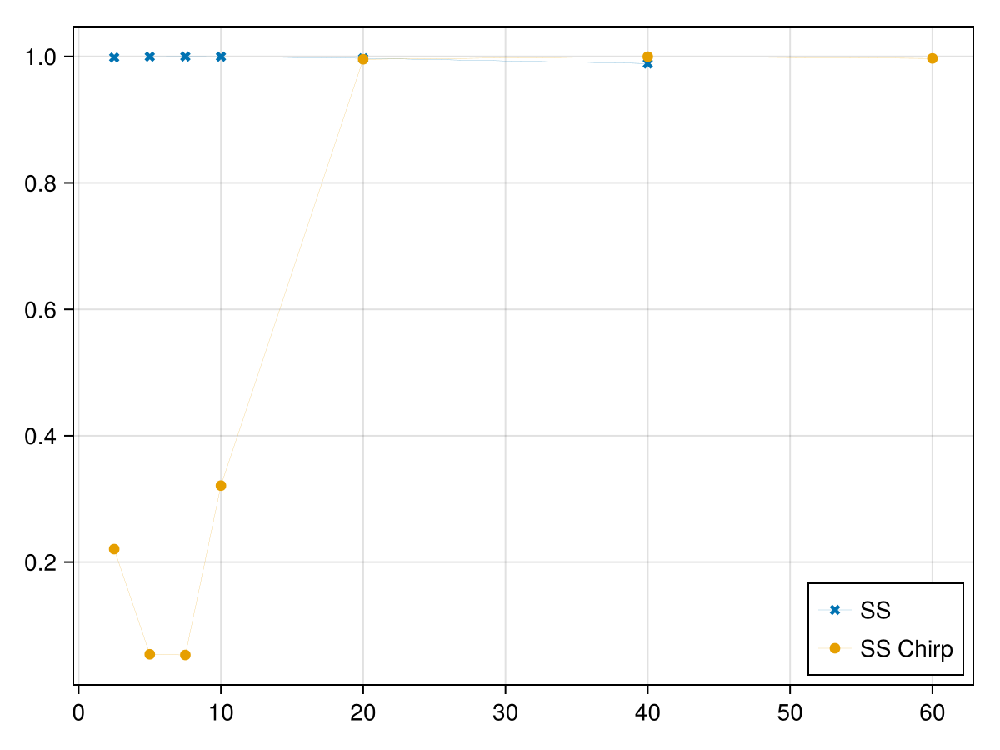

In [296]:
i = 0 
f = cm.Figure()
ax = cm.Axis(f[1,1])

cm.scatterlines!(ax, SS_x, SS, marker = :x, label = "SS", linewidth = 0.1)
cm.scatterlines!(ax, SS_chirp_x, SS_chirp, label = "SS Chirp", linewidth = 0.1)
cm.axislegend(ax, position = :rb)
f




# Checking Collapse and Dephasing Constants

In [219]:
ψ = Mode3.dressed_states[(1,0)]

qt.expect(Mode3.n̂ᵣs[1], ψ)*100

0.07595298225892647 + 0.0im

In [239]:
println(Mode3.params["kappa_tc"])
println(Mode3.params["kappa_td"])

2.0e-5
5.194805194805194e-6


In [241]:
kappa_tc = 1/56/1000

1.7857142857142855e-5

In [252]:
kappa_td = (1/47/1000-kappa_tc/2)

1.2348024316109425e-5